# Import packages

In [18]:
import csv
import torch
import math
import matplotlib.pyplot as plt
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog

# Initialise test images

In [13]:
test_folder = "Dataprojekt/Data/Clean Data/Overbite Data/Annotated Verification Data" # Change folder for other images

def test_dataset_function():
    dataset_dicts = []
    for idx, filename in enumerate(os.listdir(test_folder)):
        if filename.endswith((".jpg", ".png", ".jpeg")):
            record = {}
            file_path = os.path.join(test_folder, filename)

            height, width = cv2.imread(file_path).shape[:2]
            record["file_name"] = file_path
            record["image_id"] = idx
            record["height"] = height
            record["width"] = width
            record["annotations"] = []  # Ingen annotations (ren test data)

            dataset_dicts.append(record)
    return dataset_dicts

DatasetCatalog.register("my_test_dataset", test_dataset_function)
MetadataCatalog.get("my_test_dataset").set(thing_classes=["object"])

namespace(name='my_test_dataset', thing_classes=['object'])

# Option to remove dataset

dataset_name = "test_dataset"
if dataset_name in DatasetCatalog.list():
    DatasetCatalog.remove(dataset_name)
if dataset_name in MetadataCatalog.list():
    MetadataCatalog.pop(dataset_name)

# Initialise trained model

In [15]:
import os
import torch
import cv2
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog

# Reinitialize config
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = os.path.join("output/Overbite_Model/model_final.pth")  # Sti til modellen
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.KEYPOINT_ON = True
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_KEYPOINT_HEAD.NUM_KEYPOINTS = 1 # Matcher træning

predictor = DefaultPredictor(cfg)

print("Model reloaded successfully!")

[03/24 16:32:32 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from output/Overbite_Model/model_final.pth ...
Model reloaded successfully!


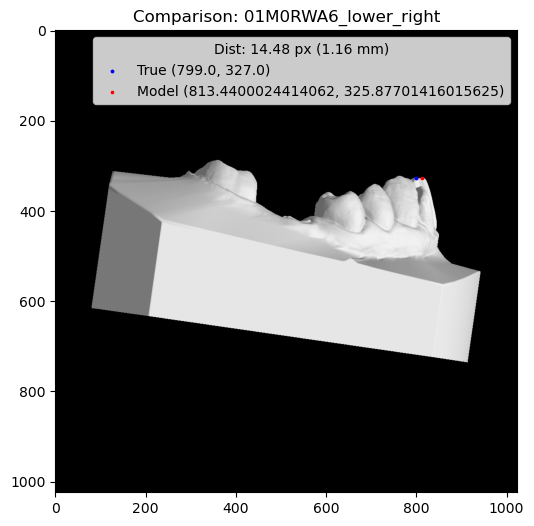

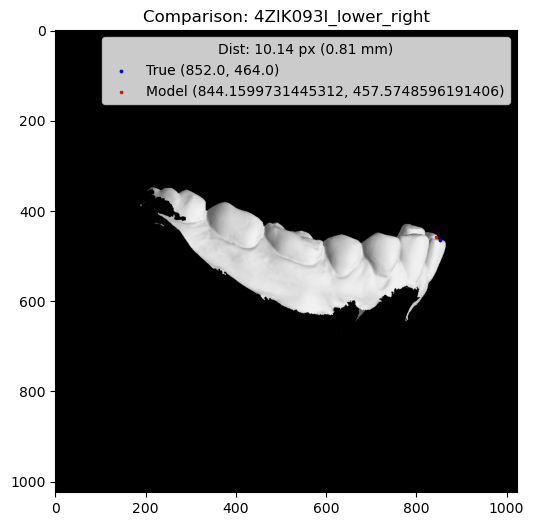

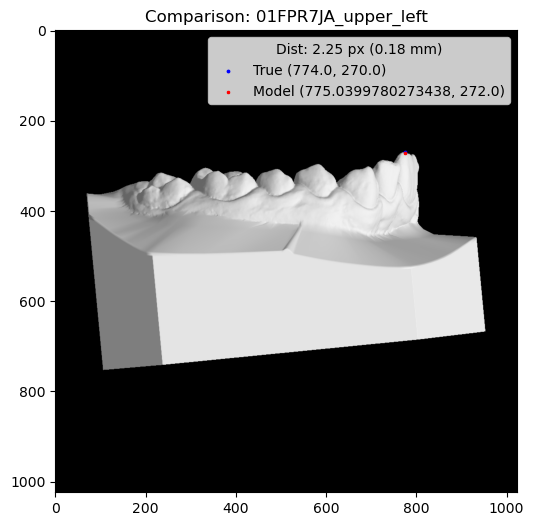

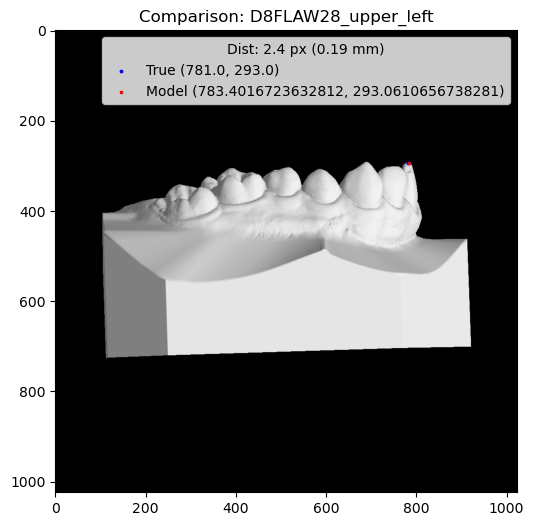

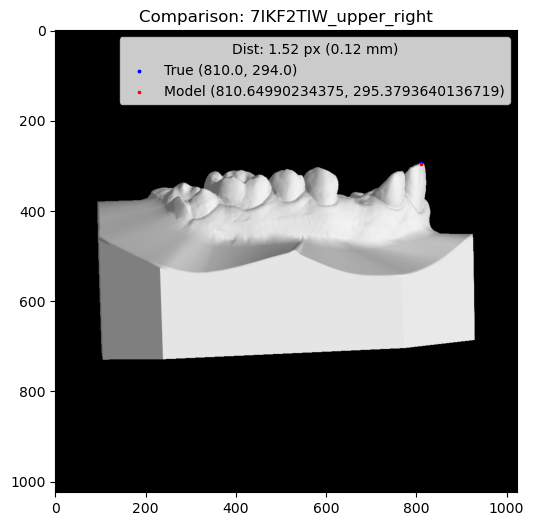

...

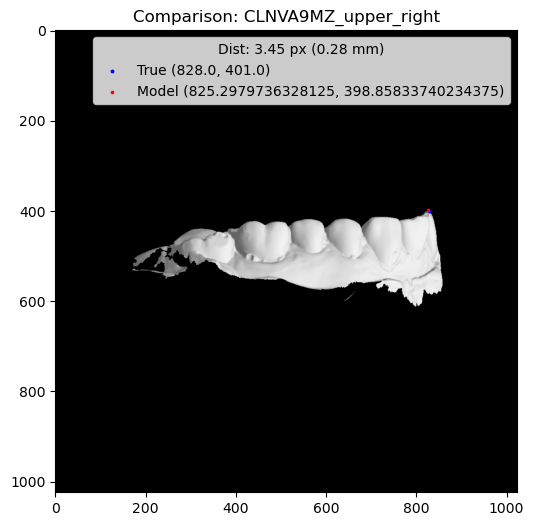

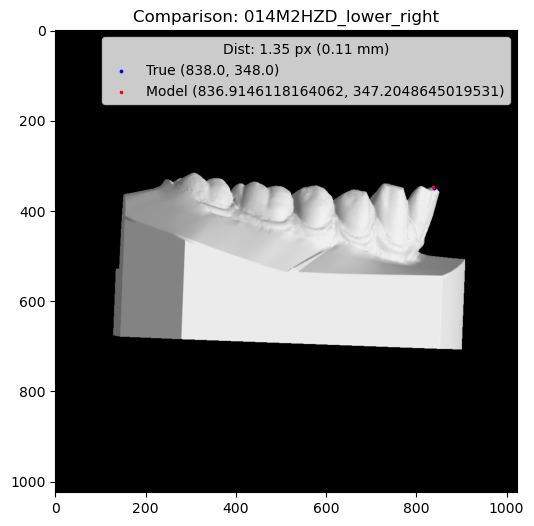

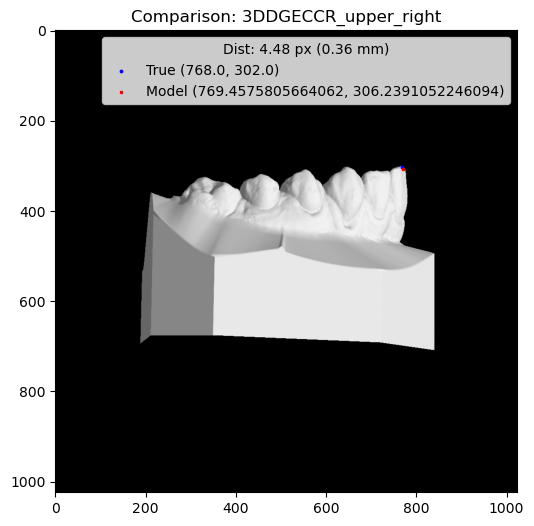

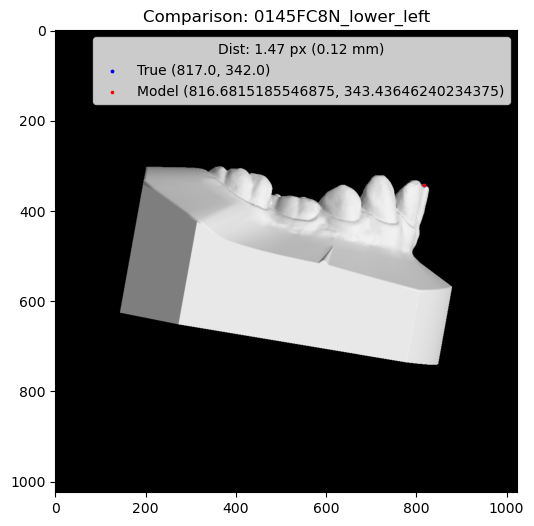

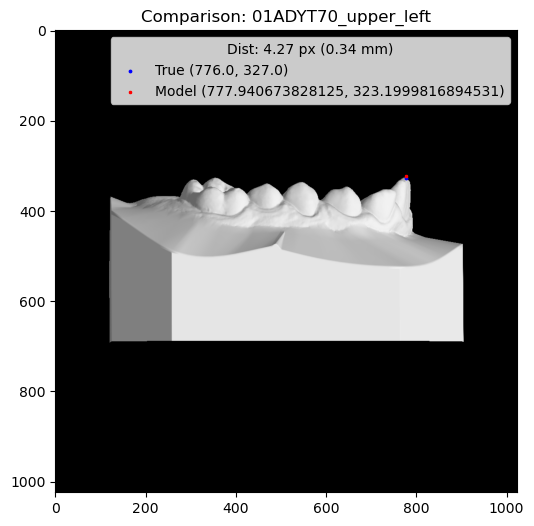

✅ Final results saved to: final_results_with_distance.csv


In [19]:
# File paths
labels_file = "Dataprojekt/Data/Clean Data/Overbite Data/Updated_Labels.csv"
image_folder = "Dataprojekt/Data/Clean Data/Overbite Data/Annotated Verification Data"
output_csv = "final_results_with_distance.csv"

# Conversion
PIXEL_TO_MM = 0.08

# Load metadata and test dataset
dataset_dicts = DatasetCatalog.get("my_test_dataset")
metadata = MetadataCatalog.get("my_test_dataset")

# === LOAD GROUND TRUTH LABELS ===
ground_truth = {}
with open(labels_file, mode="r", newline="") as file:
    reader = csv.reader(file)
    next(reader)  # Skip header
    for row in reader:
        filename, x, y = [col.strip() for col in row]
        filename = os.path.splitext(filename)[0]  # remove extension
        ground_truth[filename] = (float(x), float(y))

# === MAIN LOOP: Predict, Match, Save, Visualize ===
rows = [["Filename", "X_True", "Y_True", "X_Model", "Y_Model", "Euc_dist", "mm_Dist"]]

for sample in dataset_dicts:
    img_path = sample["file_name"]
    filename = os.path.splitext(os.path.basename(img_path))[0]

    if filename not in ground_truth:
        print(f"⚠️ No ground truth for: {filename}")
        continue

    # Read image and run prediction
    img = cv2.imread(img_path)
    outputs = predictor(img)

    instances = outputs["instances"].to("cpu")
    if not instances.has("pred_keypoints"):
        print(f"❌ No keypoints found in: {filename}")
        continue

    keypoints = instances.pred_keypoints
    if len(keypoints) == 0:
        print(f"⚠️ Empty keypoint list in: {filename}")
        continue

    # Assume first instance
    pred_x, pred_y, _ = keypoints[0][0].tolist()
    true_x, true_y = ground_truth[filename]

    # Distance
    euc_dist = round(math.sqrt((true_x - pred_x) ** 2 + (true_y - pred_y) ** 2), 2)
    mm_dist = round(euc_dist * PIXEL_TO_MM, 2)

    # Save to CSV row
    rows.append([filename, true_x, true_y, pred_x, pred_y, euc_dist, mm_dist])

    # === VISUALIZE ===
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(6, 6))
    plt.imshow(img_rgb)
    plt.scatter(true_x, true_y, color="blue", marker="o", s=3, label=f"True ({true_x}, {true_y})")
    plt.scatter(pred_x, pred_y, color="red", marker="x", s=3, label=f"Model ({pred_x}, {pred_y})")
    plt.legend(title=f"Dist: {euc_dist} px ({mm_dist} mm)")
    plt.title(f"Comparison: {filename}")
    plt.show()

# === SAVE FINAL CSV ===
with open(output_csv, mode="w", newline="") as file:
    writer = csv.writer(file)
    writer.writerows(rows)

print(f"✅ Final results saved to: {output_csv}")

# Distrubution of errors and visualisation of images with error greater than 1mm

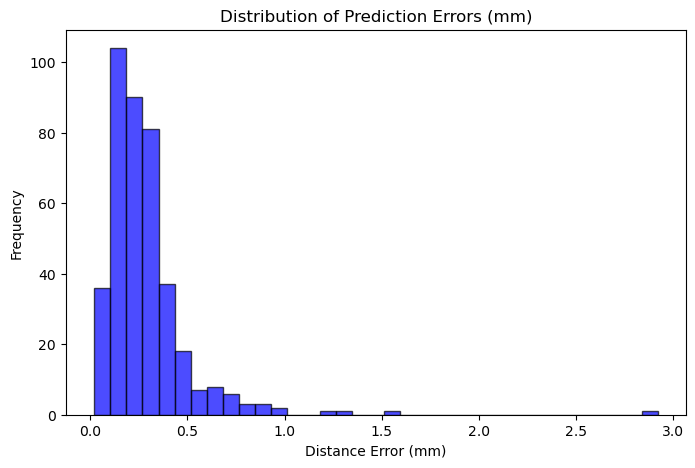

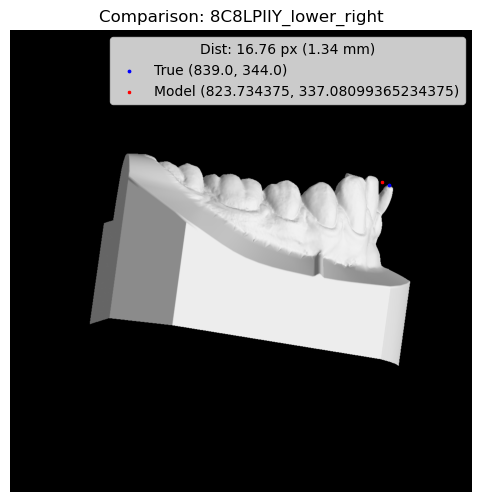

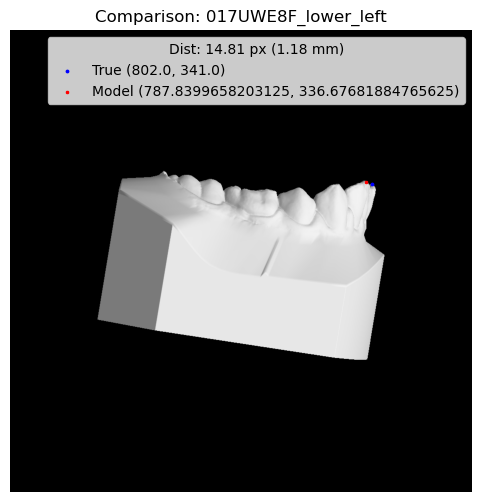

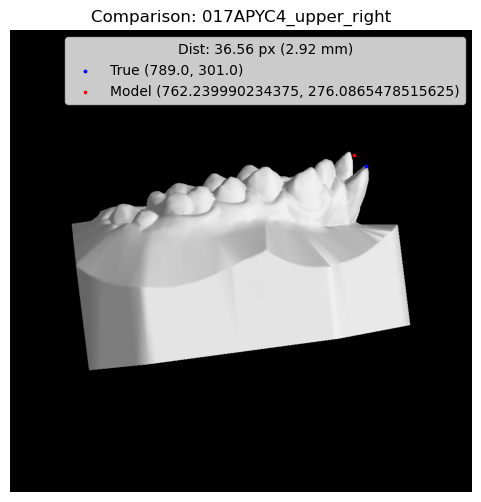

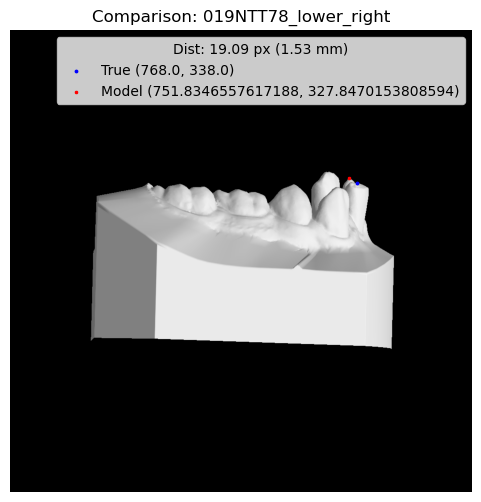

In [23]:
import csv
import cv2
import matplotlib.pyplot as plt
import os

# === CONFIGURATION ===
matched_predictions_file = "final_results_with_distance.csv"
image_folder = "Dataprojekt/Data/Clean Data/Overbite Data/Annotated Verification Data"
error_threshold_mm = 1.0
PIXEL_TO_MM = 0.08  # In case you want to reverse-calculate
image_extension = ".png"  # Change to .jpg if needed

# === LOAD DATA FROM CSV ===
distances_mm = []
high_error_rows = []

with open(matched_predictions_file, mode="r", newline="") as file:
    reader = csv.reader(file)
    next(reader)  # Skip header row 1
    next(reader)  # Skip header row 2

    for row in reader:
        filename, true_x, true_y, pred_x, pred_y, euc_dist, mm_dist = row
        mm_dist = float(mm_dist)
        distances_mm.append(mm_dist)

        if mm_dist > error_threshold_mm:
            high_error_rows.append({
                "filename": filename,
                "true_x": float(true_x),
                "true_y": float(true_y),
                "pred_x": float(pred_x),
                "pred_y": float(pred_y),
                "euc_dist": float(euc_dist),
                "mm_dist": mm_dist
            })

# === PLOT HISTOGRAM ===
plt.figure(figsize=(8, 5))
plt.hist(distances_mm, bins=35, color="blue", edgecolor="black", alpha=0.7)
plt.xlabel("Distance Error (mm)")
plt.ylabel("Frequency")
plt.title("Distribution of Prediction Errors (mm)")
plt.show()

# === DISPLAY HIGH-ERROR IMAGES ===
for row in high_error_rows:
    filename = row["filename"]
    img_path = os.path.join(image_folder, filename + image_extension)

    if not os.path.exists(img_path):
        print(f"❌ Image not found: {img_path}")
        continue

    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(6, 6))
    plt.imshow(img_rgb)
    plt.scatter(row["true_x"], row["true_y"], color="blue", marker="o", s=3, label=f"True ({row['true_x']}, {row['true_y']})")
    plt.scatter(row["pred_x"], row["pred_y"], color="red", marker="x", s=3, label=f"Model ({row['pred_x']}, {row['pred_y']})")
    plt.legend(title=f"Dist: {row['euc_dist']} px ({row['mm_dist']} mm)")
    plt.title(f"Comparison: {filename}")
    plt.axis('off')
    plt.show()
